# Final Project
### Go Ags: Sim Bun and Ariana Hernandez

### **Research Question: Using park access and changes in tenure and housing prices indicators of displacement, which census tracts in the city of Los Angeles are vulnerable to displacement?**

In [1]:
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import esda
from esda.moran import Moran, Moran_Local
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps
import plotly.express as px

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


First, we look at the housing price index.

In [2]:
# the geofile is file with the geometry element 
geofile = gpd.read_file('acs2019_5yr_B01003_14000US06037222001.geojson')
# the fhfa is the csv file with the data i want to map
fhfa = gpd.read_file('FHFA_HPI_Fixed.csv')

In [3]:
# listing what columns to keep 
columns_to_keep= ['geoid','name','B01003001','geometry']
# applying the function
geofile=geofile[columns_to_keep]

In [4]:
geofile.tail(2)

,geoid,name,B01003001,geometry
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
1004,16000US0644000,"Los Angeles, CA",3966936.0,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [5]:
geofile.columns= ['geoid','name','total population','geometry']

In [6]:
# dropping this row because it is not a census tract
geofile=geofile.drop([1004])

In [7]:
fhfa.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1640 entries, 0 to 1639
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   addition to geoid  1640 non-null   object  
 1   geoid              1640 non-null   object  
 2   field_3            1640 non-null   object  
 3   hpi 2010           1640 non-null   object  
 4   hpi 2019           1640 non-null   object  
 5   % change           1640 non-null   object  
 6   geometry           0 non-null      geometry
dtypes: geometry(1), object(6)
memory usage: 89.8+ KB


In [8]:
# listing what columns to keep 
columns_to_keep= ['field_3','hpi 2010','hpi 2019','% change','geometry']
fhfa=fhfa[columns_to_keep]

In [9]:
# getting the list for the fhfa columns so i can copy and paste it later and rename it
list(fhfa)

['field_3', 'hpi 2010', 'hpi 2019', '% change', 'geometry']

In [10]:
fhfa.columns= ['geoid', 'hpi 2010', 'hpi 2019', 'pc_hpi', 'geometry']

In [11]:
# We cannot map objects so we must change them into floats, except for the geoid column
fhfa['hpi 2010'] = fhfa ['hpi 2010'].astype(float)
fhfa['hpi 2019'] = fhfa ['hpi 2019'].astype(float)
fhfa['pc_hpi'] = fhfa ['pc_hpi'].astype(float)

In [12]:
# merging the data
fhfa=fhfa.merge(geofile,on= 'geoid')

In [13]:
# naming the columns i need to keep
columns_to_keep= ['geoid','hpi 2010','hpi 2019','pc_hpi','name','total population','geometry_y']
fhfa=fhfa[columns_to_keep]

In [14]:
#renameing geometry_y to geometry to map
fhfa.columns = ['geoid', 'hpi 2010', 'hpi 2019', 'pc_hpi', 'name','total population', 'geometry']
# checking to see if it worked 
fhfa.head(1)

,geoid,hpi 2010,hpi 2019,pc_hpi,name,total population,geometry
0,14000US06037101110,505.95,934.82,0.85,"Census Tract 1011.10, Los Angeles, CA",4283.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."


Next, we clean up the parks data. 

In [15]:
# importing the parks data
parks = gpd.read_file('SoCalParks.zip')
parks.to_file('SoCalParks.geojson', driver='GeoJSON')

In [16]:
# changing the followng data columns to strings
parks['Park_Name'] = parks ['Park_Name'].astype(str)
parks['Park_Urban'] = parks ['Park_Urban'].astype(str)
parks['Park_Desig'] = parks ['Park_Desig'].astype(str)
parks['Park_Owner'] = parks ['Park_Owner'].astype(str)
parks['Park_Local'] = parks ['Park_Local'].astype(str)
parks['Park_Manag'] = parks ['Park_Manag'].astype(str)
parks['Park_Loc_1'] = parks ['Park_Loc_1'].astype(str)
parks['Park_Statu'] = parks ['Park_Statu'].astype(str)
parks['Park_Est_D'] = parks ['Park_Est_D'].astype(str)
parks['Park_Addre'] = parks ['Park_Addre'].astype(str)
parks['Park_State'] = parks ['Park_State'].astype(str)
parks['Park_Sta_1'] = parks ['Park_Sta_1'].astype(str)
parks['Park_Count'] = parks ['Park_Count'].astype(str)   
parks['Park_Cou_1'] = parks ['Park_Cou_1'].astype(str)     
parks['Park_Place'] = parks ['Park_Place'].astype(str)
parks['Park_Pla_1'] = parks ['Park_Pla_1'].astype(str)   
parks['Park_Urb_1'] = parks ['Park_Urb_1'].astype(str)     
parks['Park_Zip'] = parks ['Park_Zip'].astype(str)
parks['Park_Bound'] = parks ['Park_Bound'].astype(str)   
parks['Park_Sourc'] = parks ['Park_Sourc'].astype(str)     
parks['Park_Feedb'] = parks ['Park_Feedb'].astype(str)
parks['Park_DateA'] = parks ['Park_DateA'].astype(str) 
parks['DataShare_'] = parks ['DataShare_'].astype(str)

Next, we clean up the tenure data

In [17]:
tenurechange = gpd.read_file('TenurePercentChange_LACounty.csv')

In [18]:
tenurechange.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2346 entries, 0 to 2345
Data columns (total 16 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   Geo_FIPS                     2346 non-null   object  
 1   Geo_GEOID                    2346 non-null   object  
 2   Geo_NAME                     2346 non-null   object  
 3   Geo_QName                    2346 non-null   object  
 4   Geo_STUSAB                   2346 non-null   object  
 5   Geo_TRACT                    2346 non-null   object  
 6   2019_Occupied Housing Units  2346 non-null   object  
 7   2019_Owners                  2346 non-null   object  
 8   2019_Renters                 2346 non-null   object  
 9   2010_Occupied Housing Units  2346 non-null   object  
 10  2010_Owners                  2346 non-null   object  
 11  2010_Renters                 2346 non-null   object  
 12  PC_OccupiedHousingUnits      2346 non-null   object  


In [19]:
#I will rename the Geo_GEOID to geoid to merge the tenure data to the fhfa data
tenurechange.rename(columns = {'Geo_GEOID':'geoid'}, inplace = True)
joined = fhfa.merge(tenurechange,on='geoid')

In [20]:
joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 575 entries, 0 to 574
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   geoid                        575 non-null    object  
 1   hpi 2010                     575 non-null    float64 
 2   hpi 2019                     575 non-null    float64 
 3   pc_hpi                       575 non-null    float64 
 4   name                         575 non-null    object  
 5   total population             575 non-null    float64 
 6   geometry_x                   575 non-null    geometry
 7   Geo_FIPS                     575 non-null    object  
 8   Geo_NAME                     575 non-null    object  
 9   Geo_QName                    575 non-null    object  
 10  Geo_STUSAB                   575 non-null    object  
 11  Geo_TRACT                    575 non-null    object  
 12  2019_Occupied Housing Units  575 non-null    object  
 13  2019_

In [21]:
# Once again, we are renaming the geometry and keeping only one
joined.rename(columns = {'geometry_x':'geometry'}, inplace = True)
joined=joined.drop(columns=['geometry_y'])

In [22]:
joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 575 entries, 0 to 574
Data columns (total 21 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   geoid                        575 non-null    object  
 1   hpi 2010                     575 non-null    float64 
 2   hpi 2019                     575 non-null    float64 
 3   pc_hpi                       575 non-null    float64 
 4   name                         575 non-null    object  
 5   total population             575 non-null    float64 
 6   geometry                     575 non-null    geometry
 7   Geo_FIPS                     575 non-null    object  
 8   Geo_NAME                     575 non-null    object  
 9   Geo_QName                    575 non-null    object  
 10  Geo_STUSAB                   575 non-null    object  
 11  Geo_TRACT                    575 non-null    object  
 12  2019_Occupied Housing Units  575 non-null    object  
 13  2019_

In [23]:
# I'm going to drop some columns since we don't need them all. 
joined=joined.drop(columns=['2019_Occupied Housing Units','2019_Owners','2019_Renters','2010_Occupied Housing Units','2010_Owners','2010_Renters'])

In [24]:
#I'm going to change PC_Renters to a float variable bc we'll need that later on
joined['PC_Renters'] = joined ['PC_Renters'].astype(float)

In [25]:
joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 575 entries, 0 to 574
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   geoid                    575 non-null    object  
 1   hpi 2010                 575 non-null    float64 
 2   hpi 2019                 575 non-null    float64 
 3   pc_hpi                   575 non-null    float64 
 4   name                     575 non-null    object  
 5   total population         575 non-null    float64 
 6   geometry                 575 non-null    geometry
 7   Geo_FIPS                 575 non-null    object  
 8   Geo_NAME                 575 non-null    object  
 9   Geo_QName                575 non-null    object  
 10  Geo_STUSAB               575 non-null    object  
 11  Geo_TRACT                575 non-null    object  
 12  PC_OccupiedHousingUnits  575 non-null    object  
 13  PC_Owners                575 non-null    object  
 14  PC_Renters

Putting parks, tenure, and hpi together. 

In [26]:
# addressing the error as there is no Dataframe
from geopandas import GeoDataFrame
# updating the dataset so it is a dataframe
joined = GeoDataFrame(joined) # i did this one already but i think it should be good to have it all in one place
parks= GeoDataFrame(parks)

joined = joined.to_crs(epsg=3857)
parks = parks.to_crs(epsg=3857)

In [27]:
# now I am joining the parks and fhfa dataset. 
# from my understanding this is different from merging as we are not merging it using a column.
parks_join = gpd.sjoin(joined, parks, how='left')

# checking to see if the function worked
parks_join.head(2)

,geoid,hpi 2010,hpi 2019,pc_hpi,name,total population,geometry,Geo_FIPS,Geo_NAME,Geo_QName,...,SUM_BLACK_,SUM_AMERIN,SUM_ASIAN_,SUM_PACIFI,SUM_OTHRAC,SUM_RACE2U,SUM_HISP_S,PLACEKEY,Shape_Leng,Shape_Area
0,14000US06037101110,505.95,934.82,0.85,"Census Tract 1011.10, Los Angeles, CA",4283.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",...,76.0,13.0,626.0,3.0,11.0,238.0,2082.0,@5z5-36j-zpv,605.518592,14813.085294
0,14000US06037101110,505.95,934.82,0.85,"Census Tract 1011.10, Los Angeles, CA",4283.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",...,23.0,9.0,509.0,3.0,13.0,122.0,1166.0,@5z5-36c-n5z,242.223533,3048.176529


In [28]:
parks_join.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 786 entries, 0 to 574
Data columns (total 67 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   geoid                    786 non-null    object  
 1   hpi 2010                 786 non-null    float64 
 2   hpi 2019                 786 non-null    float64 
 3   pc_hpi                   786 non-null    float64 
 4   name                     786 non-null    object  
 5   total population         786 non-null    float64 
 6   geometry                 786 non-null    geometry
 7   Geo_FIPS                 786 non-null    object  
 8   Geo_NAME                 786 non-null    object  
 9   Geo_QName                786 non-null    object  
 10  Geo_STUSAB               786 non-null    object  
 11  Geo_TRACT                786 non-null    object  
 12  PC_OccupiedHousingUnits  786 non-null    object  
 13  PC_Owners                786 non-null    object  
 14  PC

Next, we'll create a parks count variable for our parks index. 

In [29]:
parks_by_ct = parks_join.geoid.value_counts().rename_axis('geoid').reset_index(name='parks_count')
parks_by_ct.head(3)

,geoid,parks_count
0,14000US06037143901,9
1,14000US06037181000,8
2,14000US06037185100,8


In [30]:
parks=parks_join.merge(parks_by_ct, on ='geoid') 
parks.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 786 entries, 0 to 785
Data columns (total 68 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   geoid                    786 non-null    object  
 1   hpi 2010                 786 non-null    float64 
 2   hpi 2019                 786 non-null    float64 
 3   pc_hpi                   786 non-null    float64 
 4   name                     786 non-null    object  
 5   total population         786 non-null    float64 
 6   geometry                 786 non-null    geometry
 7   Geo_FIPS                 786 non-null    object  
 8   Geo_NAME                 786 non-null    object  
 9   Geo_QName                786 non-null    object  
 10  Geo_STUSAB               786 non-null    object  
 11  Geo_TRACT                786 non-null    object  
 12  PC_OccupiedHousingUnits  786 non-null    object  
 13  PC_Owners                786 non-null    object  
 14  PC

In [31]:
parks.sample()

,geoid,hpi 2010,hpi 2019,pc_hpi,name,total population,geometry,Geo_FIPS,Geo_NAME,Geo_QName,...,SUM_AMERIN,SUM_ASIAN_,SUM_PACIFI,SUM_OTHRAC,SUM_RACE2U,SUM_HISP_S,PLACEKEY,Shape_Leng,Shape_Area,parks_count
307,14000US06037134001,195.34,334.32,0.71,"Census Tract 1340.01, Los Angeles, CA",3864.0,"MULTIPOLYGON (((-13201695.562 4056806.173, -13...",6037134001,Census Tract 1340.01,"Census Tract 1340.01, Los Angeles County, Cali...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1


### Normalizing the parks data and creating the park index

In [32]:
parks['parks_per_1000'] = parks['parks_count']/(parks['total population'])*1000
parks['parkacre_per_1000'] = parks['Park_Size_']/(parks['total population'])*1000

In [33]:
parks.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 786 entries, 0 to 785
Data columns (total 70 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   geoid                    786 non-null    object  
 1   hpi 2010                 786 non-null    float64 
 2   hpi 2019                 786 non-null    float64 
 3   pc_hpi                   786 non-null    float64 
 4   name                     786 non-null    object  
 5   total population         786 non-null    float64 
 6   geometry                 786 non-null    geometry
 7   Geo_FIPS                 786 non-null    object  
 8   Geo_NAME                 786 non-null    object  
 9   Geo_QName                786 non-null    object  
 10  Geo_STUSAB               786 non-null    object  
 11  Geo_TRACT                786 non-null    object  
 12  PC_OccupiedHousingUnits  786 non-null    object  
 13  PC_Owners                786 non-null    object  
 14  PC

In [38]:
parks['parks_per_1000'].describe()

count    786.000000
mean       0.544393
std        0.487413
min        0.114482
25%        0.226899
50%        0.331017
75%        0.688863
max        2.784223
Name: parks_per_1000, dtype: float64

Now, we have the quantiles for the parks per thousand section of the matrix: 

1 = 0-0.226899

2 = 0.226899-0.331017

3 = 0.331017-0.6888636

4 = >0.688863

In [34]:
parks['parkacre_per_1000'].describe()

count     486.000000
mean       58.295757
std       362.197999
min         0.005624
25%         0.399703
50%         1.825870
75%         9.122337
max      5307.785830
Name: parkacre_per_1000, dtype: float64

Now, we have the quantiles for the park size(acres) per thousand section of the matrix: 

1 = 0-0.399703

2 = 0.399703-1.825870

3 = 1.825870- 9.122337

4 = >1.825870

Parks per thousand people:

25% = 1; lowest amount of parks per 1000 people
50% = 2
75% = 3
100% = 4; highest amount of parks per 1000 people

Park size(acre) per thousand people:

25% = 1; smallest amount of parks per 1000 people
50% = 2
75% = 3
100% = 4; largest amount of parks per 1000 people

In [35]:
# Now, we'll create a new column for parkacre_index and park_index
conditions = [
    (parks['parks_per_1000'] < 0.226899), # lowest parks
    (parks['parks_per_1000'] < 0.331017 ) & (parks['parks_per_1000'] >= 0.226899),   #second lowest
    (parks['parks_per_1000'] <0.6888636) & (parks['parks_per_1000'] >= 0.331017), #second highest
    (parks['parks_per_1000'] >=0.6888636)    # highest parks
    ]


# create a list of the values we want to assign for each condition
values = [
    1, 
    2, 
    3, 
    4
    ]

# create a new column and use np.select to assign values to it using our lists as arguments
import numpy as np
parks['parkcount_index'] = np.select(conditions, values)

In [36]:
conditions = [
    (parks['parkacre_per_1000'] < 0.399703), # lowest parks
    (parks['parkacre_per_1000'] < 1.825870 ) & (parks['parkacre_per_1000'] >= 0.399703 ),   #second lowest
    (parks['parkacre_per_1000'] <9.122337) & (parks['parkacre_per_1000'] >= 1.825870), #second highest
    (parks['parkacre_per_1000'] >=9.122337)    # highest parks
    ]


# create a list of the values we want to assign for each condition
values = [
    1, 
    2, 
    3, 
    4
    ]

# create a new column and use np.select to assign values to it using our lists as arguments
import numpy as np
parks['parkacre_index'] = np.select(conditions, values)

In [37]:
parks.sample()

,geoid,hpi 2010,hpi 2019,pc_hpi,name,total population,geometry,Geo_FIPS,Geo_NAME,Geo_QName,...,SUM_RACE2U,SUM_HISP_S,PLACEKEY,Shape_Leng,Shape_Area,parks_count,parks_per_1000,parkacre_per_1000,parkcount_index,parkacre_index
401,14000US06037143300,389.25,656.84,0.69,"Census Tract 1433, Los Angeles, CA",6643.0,"MULTIPOLYGON (((-13179836.311 4049985.421, -13...",6037143300,Census Tract 1433,"Census Tract 1433, Los Angeles County, California",...,262.0,801.0,@5z4-zfv-8gk,657.890453,13019.656541,1,0.150534,0.484303,1,2


In [38]:
parks['park_index'] = parks['parkcount_index'] + parks['parkacre_index']

In [39]:
parks.sample()

,geoid,hpi 2010,hpi 2019,pc_hpi,name,total population,geometry,Geo_FIPS,Geo_NAME,Geo_QName,...,SUM_HISP_S,PLACEKEY,Shape_Leng,Shape_Area,parks_count,parks_per_1000,parkacre_per_1000,parkcount_index,parkacre_index,park_index
40,14000US06037104124,301.63,564.03,0.87,"Census Tract 1041.24, Los Angeles, CA",3875.0,"MULTIPOLYGON (((-13179315.447 4066141.344, -13...",6037104124,Census Tract 1041.24,"Census Tract 1041.24, Los Angeles County, Cali...",...,117.0,@5z4-vsf-s5z,1812.030835,160307.813536,3,0.774194,10.222689,4,4,8


Now, our park index is complete! Let's create some charts and maps. 

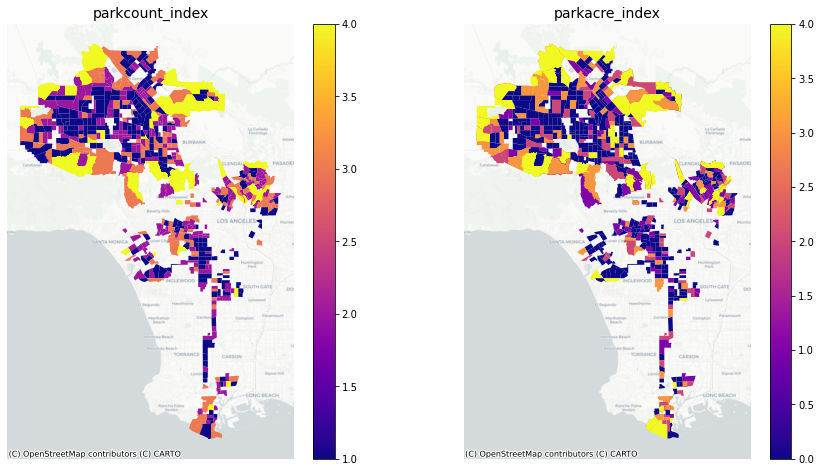

In [40]:
column1 = 'parkcount_index'
column2 = 'parkacre_index'
fig,ax = plt.subplots(1,2,figsize=(15,8))

parks.plot(ax=ax[0],
         column=column1,
         legend=True, 
         cmap='plasma'
        )

ax[0].set_title(column1, fontsize=14)
ax[0].axis('off');

parks.plot(ax=ax[1],
         column=column2,
         legend=True,
         cmap='plasma'
        )
ctx.add_basemap(ax[0],source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(ax[1],source=ctx.providers.CartoDB.Positron)
ax[1].set_title(column2, fontsize=14)
ax[1].axis('off');


These maps look very similar, let's map the park_index together. 

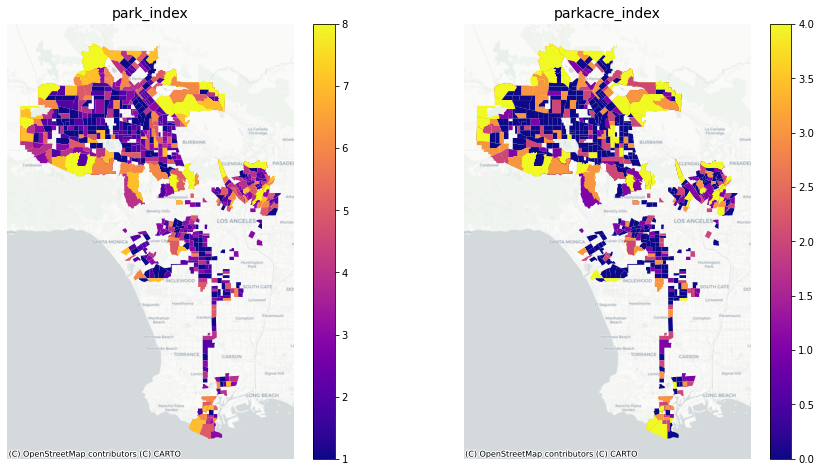

In [41]:
column1 = 'park_index'
column2 = 'parkacre_index'
fig,ax = plt.subplots(1,2,figsize=(15,8))

parks.plot(ax=ax[0],
         column=column1,
         legend=True, 
         cmap='plasma'
        )

ax[0].set_title(column1, fontsize=14)
ax[0].axis('off');

parks.plot(ax=ax[1],
         column=column2,
         legend=True,
         cmap='plasma'
        )
ctx.add_basemap(ax[0],source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(ax[1],source=ctx.providers.CartoDB.Positron)
ax[1].set_title(column2, fontsize=14)
ax[1].axis('off');

Next, let's create some bar charts of our data:

Text(0, 0.5, 'Frequency')

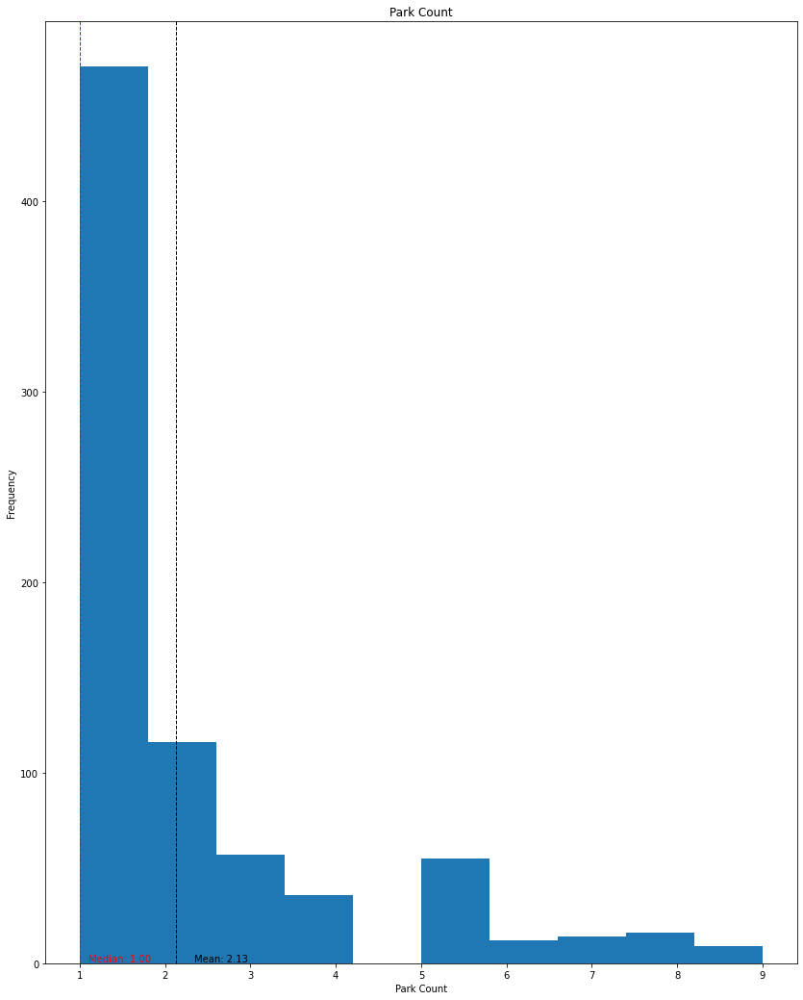

In [42]:
plt.axvline(parks.parks_count.mean(), color='k', linestyle='dashed', linewidth=1)
plt.axvline(parks.parks_count.median(), color='r', linestyle='dashed', linewidth=1)
min_ylim, max_ylim = plt.ylim()
plt.text(parks.parks_count.mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(parks.parks_count.mean()))
plt.text(parks.parks_count.median()*1.1, max_ylim*0.8, 'Median: {:.2f}'.format(parks.parks_count.median()),color='r')

ax=parks['parks_count'].plot.hist(figsize=(14,18),title="Park Count")
ax.set_xlabel("Park Count")
ax.set_ylabel("Frequency")

Text(0, 0.5, 'Frequency')

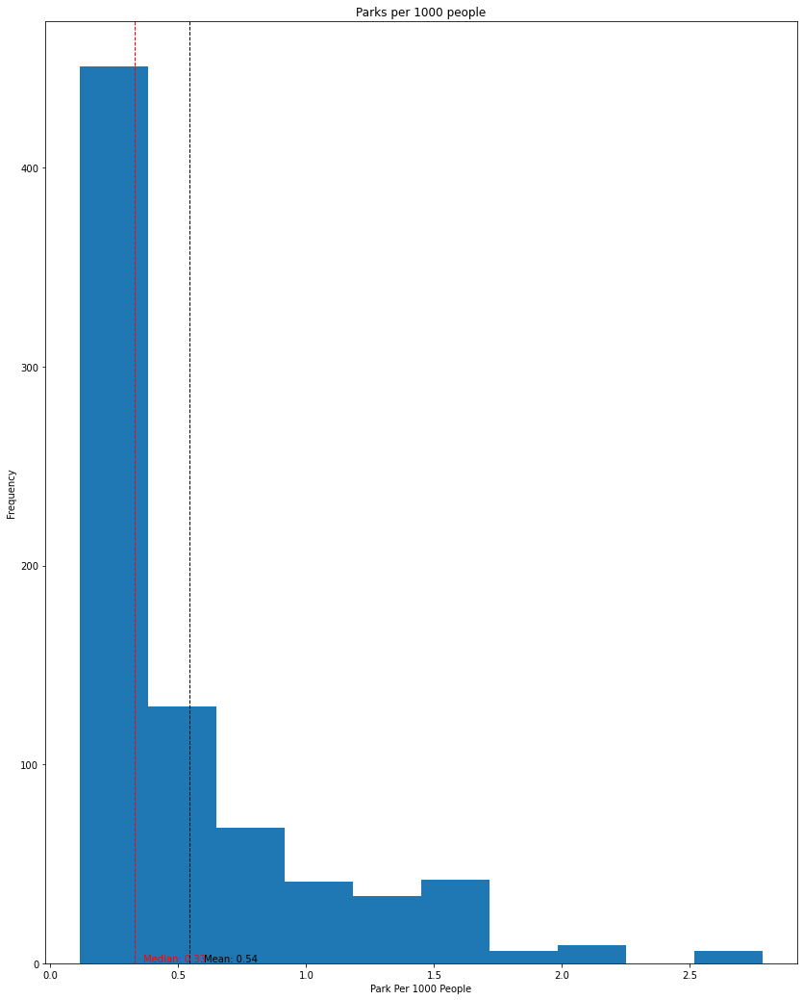

In [43]:
plt.axvline(parks.parks_per_1000.mean(), color='k', linestyle='dashed', linewidth=1)
plt.axvline(parks.parks_per_1000.median(), color='r', linestyle='dashed', linewidth=1)
min_ylim, max_ylim = plt.ylim()
plt.text(parks.parks_per_1000.mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(parks.parks_per_1000.mean()))
plt.text(parks.parks_per_1000.median()*1.1, max_ylim*0.8, 'Median: {:.2f}'.format(parks.parks_per_1000.median()),color='r')

ax=parks['parks_per_1000'].plot.hist(figsize=(14,18),title="Parks per 1000 people")
ax.set_xlabel("Park Per 1000 People")
ax.set_ylabel("Frequency")

Text(0, 0.5, 'Frequency')

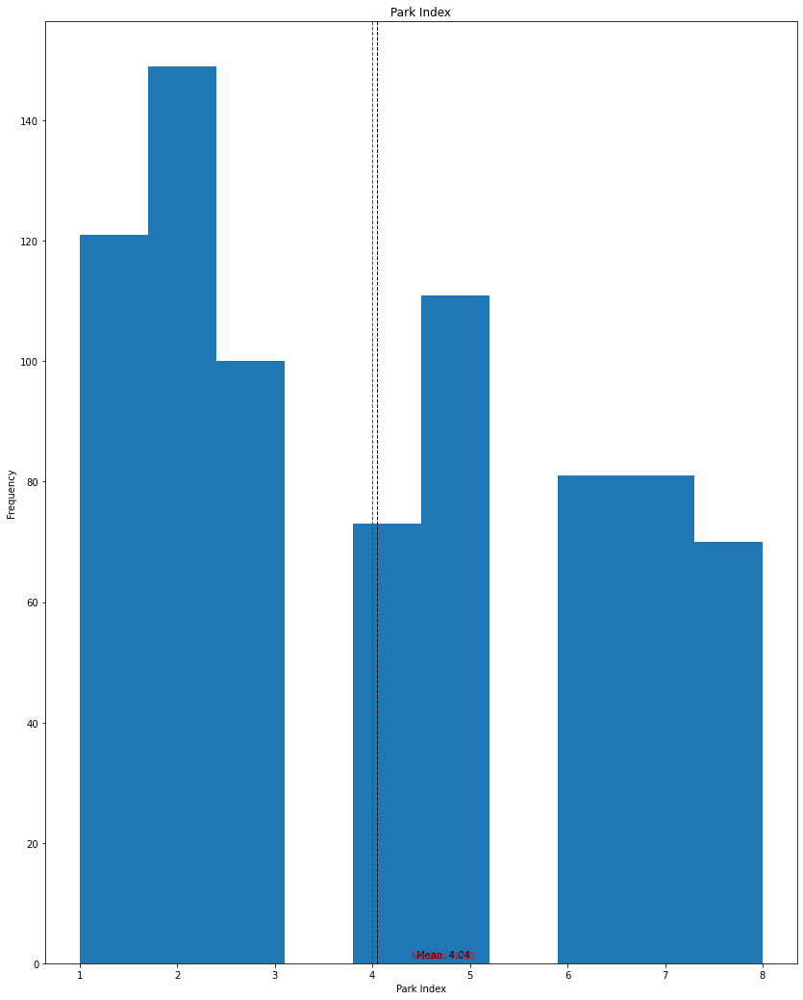

In [44]:

plt.axvline(parks.park_index.mean(), color='k', linestyle='dashed', linewidth=1)
plt.axvline(parks.park_index.median(), color='r', linestyle='dashed', linewidth=1)
min_ylim, max_ylim = plt.ylim()
plt.text(parks.park_index.mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(parks.park_index.mean()))
plt.text(parks.park_index.median()*1.1, max_ylim*0.8, 'Median: {:.2f}'.format(parks.park_index.median()),color='r')

ax=parks['park_index'].plot.hist(figsize=(14,18),title="Park Index")
parks.sort_values(by='park_index')

ax.set_xlabel("Park Index")
ax.set_ylabel("Frequency")


In [45]:
parks['park_index'].describe()

count    786.000000
mean       4.044529
std        2.276281
min        1.000000
25%        2.000000
50%        4.000000
75%        6.000000
max        8.000000
Name: park_index, dtype: float64

### Creating the displacement Index

In [46]:
parks['pc_hpi'].describe()

count    786.000000
mean       0.822201
std        0.323753
min        0.080000
25%        0.580000
50%        0.780000
75%        1.000000
max        2.070000
Name: pc_hpi, dtype: float64

1 = 0-0.580000

2 = 0.580000-0.780000

3 = 0.760000-1.000000

4 = >1.000000

Percent Change in Housing Prices

25% = 1; lowest increase in housing prices
50% = 2
75% = 3
100% = 4; highest increase in housing prices

In [47]:
conditions = [
    (parks['pc_hpi'] < 0.580000), # lowest increase (highest decrease) in percent change in housing prices
    (parks['pc_hpi'] < 0.760000 ) & (parks['pc_hpi'] >= 0.580000),   #second lowest
    (parks['pc_hpi'] <1.000000) & (parks['pc_hpi'] >= 0.760000), #second highest
    (parks['pc_hpi'] >=1.000000)    # highest increase in percent change in housing prices
    ]


# create a list of the values we want to assign for each condition
values = [
    1, 
    2, 
    3, 
    4
    ]

# create a new column and use np.select to assign values to it using our lists as arguments
import numpy as np
parks['hpi_index'] = np.select(conditions, values)

In [48]:
parks['PC_Renters'].describe()

count     786.000000
mean       26.037540
std        80.671888
min       -47.209302
25%        -4.025495
50%         9.539726
75%        27.807414
max      1025.000000
Name: PC_Renters, dtype: float64

For percent change in renters, the quantiles will go:

1 = >27.807414

2 =  9.539726- 27.807414

3 = -4.025495 - 9.539726

4 = <-4.025495

We chose to have it so that the first quantile is for percent change in renters with the highest increase and the fourth quantile is for percent change in renters with the highest decrease.

In [49]:
conditions1 = [
    (parks['PC_Renters'] <-4.025495), # lowest increase (highest decrease) in percent change in renters
    (parks['PC_Renters'] < 9.539726) & (parks['PC_Renters'] >= -4.025495),   
    (parks['PC_Renters'] < 27.807414) & (parks['PC_Renters'] >= 9.539726), 
    (parks['PC_Renters'] >= 27.807414)    # highest increase in percent change in renters
    ]


# create a list of the values we want to assign for each condition
values1 = [
    4, 
    3, 
    2, 
    1
    ]

# create a new column and use np.select to assign values to it using our lists as arguments
parks['renter_index'] = np.select(conditions1, values1)

In [50]:
parks['disp_index'] = parks['hpi_index'] + parks['renter_index']

In [51]:
parks['disp_index'].describe()

count    786.000000
mean       5.039440
std        1.698923
min        2.000000
25%        4.000000
50%        5.000000
75%        6.000000
max        8.000000
Name: disp_index, dtype: float64

In [52]:
parks.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 786 entries, 0 to 785
Data columns (total 76 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   geoid                    786 non-null    object  
 1   hpi 2010                 786 non-null    float64 
 2   hpi 2019                 786 non-null    float64 
 3   pc_hpi                   786 non-null    float64 
 4   name                     786 non-null    object  
 5   total population         786 non-null    float64 
 6   geometry                 786 non-null    geometry
 7   Geo_FIPS                 786 non-null    object  
 8   Geo_NAME                 786 non-null    object  
 9   Geo_QName                786 non-null    object  
 10  Geo_STUSAB               786 non-null    object  
 11  Geo_TRACT                786 non-null    object  
 12  PC_OccupiedHousingUnits  786 non-null    object  
 13  PC_Owners                786 non-null    object  
 14  PC

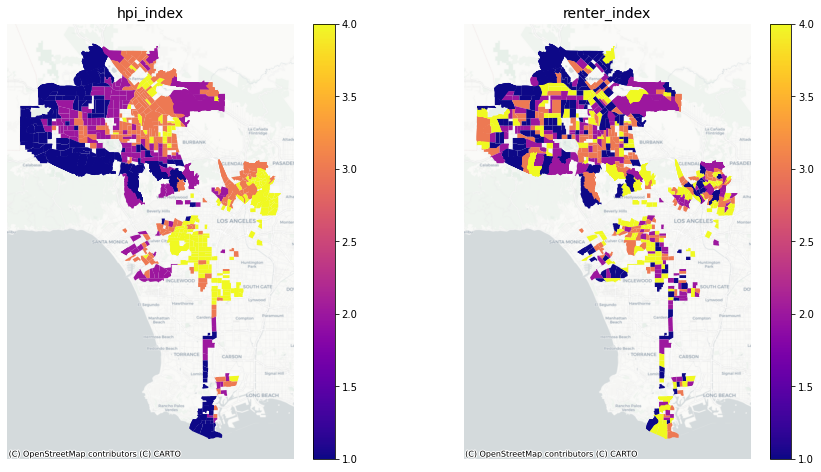

In [53]:
column1 = 'hpi_index'
column2 = 'renter_index'
fig,ax = plt.subplots(1,2,figsize=(15,8))

parks.plot(ax=ax[0],
         column=column1,
         legend=True, 
         cmap='plasma'
        )

ax[0].set_title(column1, fontsize=14)
ax[0].axis('off');

parks.plot(ax=ax[1],
         column=column2,
         legend=True,
         cmap='plasma'
        )
ctx.add_basemap(ax[0],source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(ax[1],source=ctx.providers.CartoDB.Positron)
ax[1].set_title(column2, fontsize=14)
ax[1].axis('off');

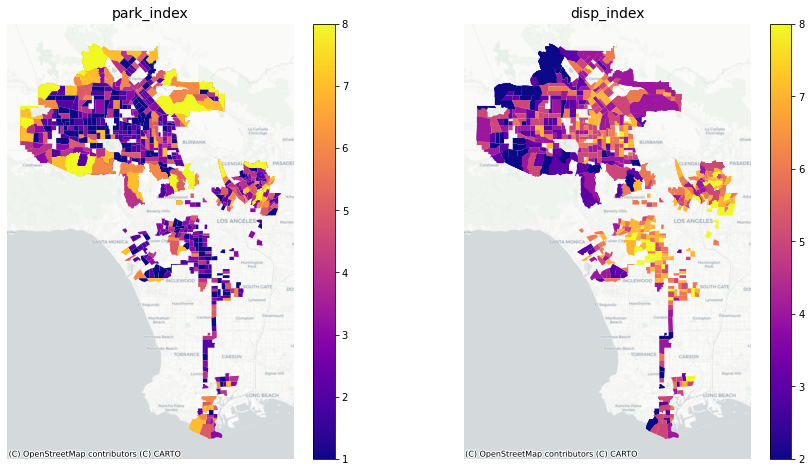

In [54]:
column1 = 'park_index'
column2 = 'disp_index'
fig,ax = plt.subplots(1,2,figsize=(15,8))

parks.plot(ax=ax[0],
         column=column1,
         legend=True, 
         cmap='plasma'
        )

ax[0].set_title(column1, fontsize=14)
ax[0].axis('off');

parks.plot(ax=ax[1],
         column=column2,
         legend=True,
         cmap='plasma'
        )
ctx.add_basemap(ax[0],source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(ax[1],source=ctx.providers.CartoDB.Positron)
ax[1].set_title(column2, fontsize=14)
ax[1].axis('off');

Now, we can compare the displacement index with the park index. I think most notable is the area near Culver City, displacement is very high and parks are very low. 

Text(0, 0.5, 'Frequency')

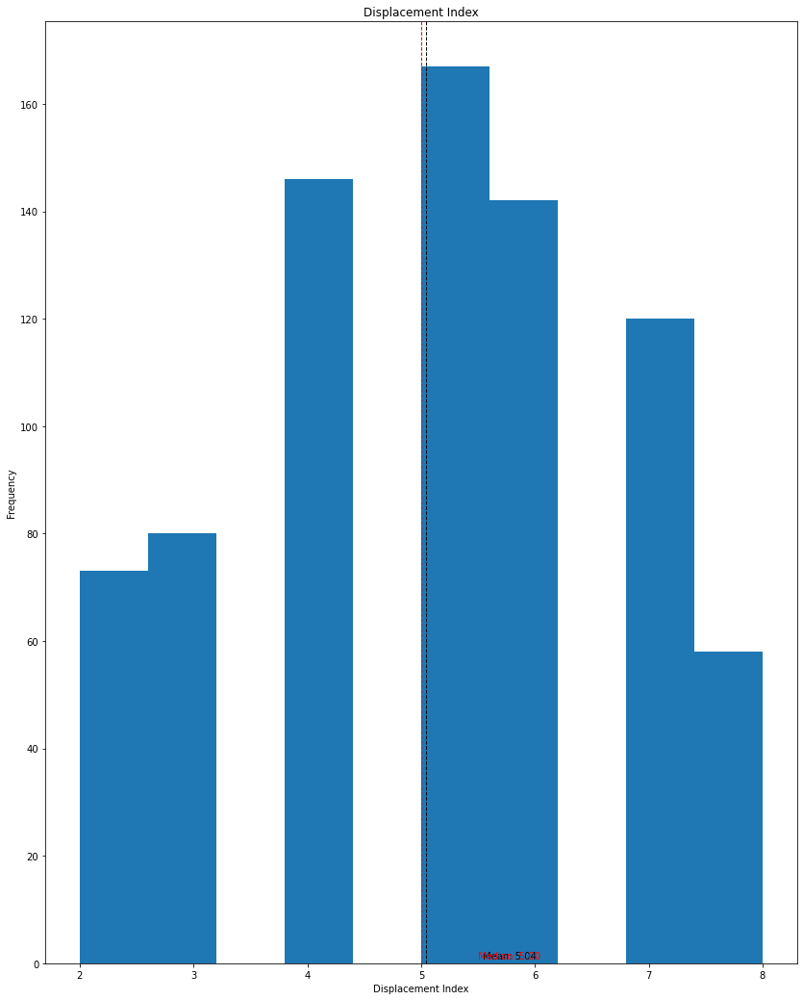

In [55]:
plt.axvline(parks.disp_index.mean(), color='k', linestyle='dashed', linewidth=1)
plt.axvline(parks.disp_index.median(), color='r', linestyle='dashed', linewidth=1)
min_ylim, max_ylim = plt.ylim()
plt.text(parks.disp_index.mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(parks.disp_index.mean()))
plt.text(parks.disp_index.median()*1.1, max_ylim*0.8, 'Median: {:.2f}'.format(parks.disp_index.median()),color='r')

ax=parks['disp_index'].plot.hist(figsize=(14,18),title="Displacement Index")
parks.sort_values(by='disp_index')

ax.set_xlabel("Displacement Index")
ax.set_ylabel("Frequency")

## Interactive Maps

In [56]:
# interactive version needs to be in WGS84
parks_web = parks.to_crs('EPSG:4326')

In [57]:
# what's the centroid?
minx, miny, maxx, maxy = parks_web.geometry.total_bounds
center_lat_parks_web = (maxy-miny)/2+miny
center_lon_parks_web = (maxx-minx)/2+minx

In [58]:
parks_web.disp_index.describe()

count    786.000000
mean       5.039440
std        1.698923
min        2.000000
25%        4.000000
50%        5.000000
75%        6.000000
max        8.000000
Name: disp_index, dtype: float64

In [59]:
# grab the median
median = parks_web.disp_index.median() 

In [60]:
token='pk.eyJ1IjoiaG9vZGluYyIsImEiOiJja3pzdTJuMGQwOHhzMnZtaDIyMDU5Nzk3In0.KlNbgSNa7s6XD2BPuP24ww'
px.set_mapbox_access_token(token)

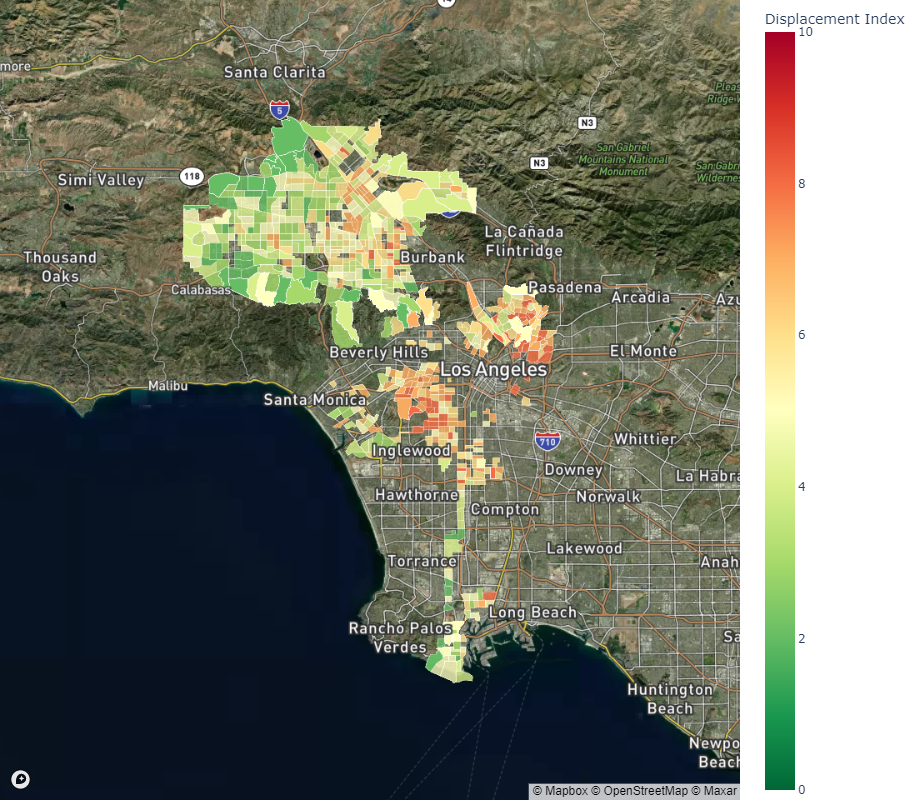

In [61]:
fig = px.choropleth_mapbox(parks_web, 
                     geojson=parks_web.geometry, # the geometry column
                     locations=parks_web.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='disp_index',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint =median, # put the median as the midpoint
                     range_color =(0,median*2),
                     hover_data=['Park_Name','Park_Local','geoid','pc_hpi','parks_count','parks_per_1000','park_index', 'parkcount_index', 'parkacre_index','hpi_index','renter_index','disp_index'],
                     center = {"lat":center_lat_parks_web, "lon":center_lon_parks_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'parks_per_1000':'Parks per 1000',
                             'disp_index':'Displacement Index',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})


In [62]:
fig.write_html("Displace_map_plotly.html")

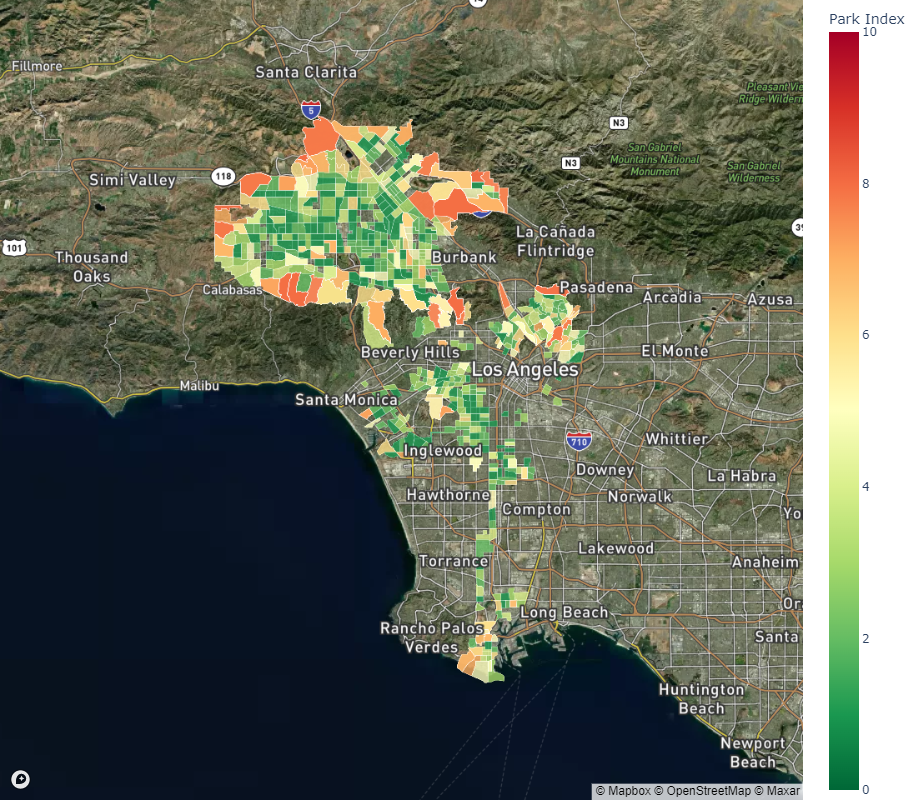

In [75]:
fig = px.choropleth_mapbox(parks_web, 
                     geojson=parks_web.geometry, # the geometry column
                     locations=parks_web.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='park_index',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint =median, # put the median as the midpoint
                     range_color =(0,median*2),
                     hover_data=['Park_Name','Park_Local','geoid','pc_hpi','parks_count','parks_per_1000','park_index','parkcount_index','parkacre_index'],
                     center = {"lat":center_lat_parks_web, "lon":center_lon_parks_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'parks_per_1000':'Parks per 1000',
                             'park_index':'Park Index',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})


In [77]:
fig.write_html("park_map_plotly.html")

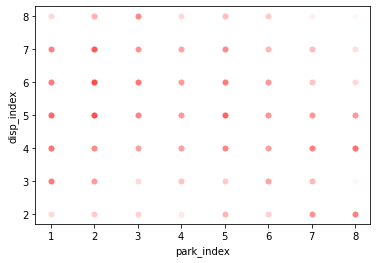

In [98]:
import seaborn as sns
sns.scatterplot(x="park_index", y="disp_index", alpha =0.03, color = 'red', data=parks);

We attempted to use a scatterplot to determine correlation. However, this does not seem very helpful and displays not clear pattern, which may be a finding in itself. 

<AxesSubplot:xlabel='park_index', ylabel='disp_index'>

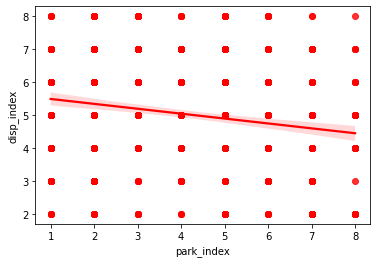

In [99]:
sns.regplot(x="park_index", y="disp_index", color = 'red',data=parks)

In [88]:
parks.corr(method='pearson')

,hpi 2010,hpi 2019,pc_hpi,total population,PC_Renters,index_right,OBJECTID,GISTrkrID,SourceID,Park_Acces,...,Shape_Area,parks_count,parks_per_1000,parkacre_per_1000,parkcount_index,parkacre_index,park_index,hpi_index,renter_index,disp_index
hpi 2010,1.000000,0.938503,-0.440083,0.159342,0.212456,-0.013098,-0.022349,-0.006667,0.065466,0.013312,...,0.033575,0.236265,0.144576,0.015797,0.095311,0.147904,0.144379,-0.397443,-0.139981,-0.354358
hpi 2019,0.938503,1.000000,-0.141283,0.184597,0.122934,-0.045335,-0.038187,-0.042306,0.054110,-0.019000,...,-0.009121,0.179388,0.059412,-0.026565,0.043815,0.071990,0.069008,-0.091960,-0.089996,-0.119964
pc_hpi,-0.440083,-0.141283,1.000000,0.064302,-0.199070,-0.093043,-0.047569,-0.101587,-0.056228,-0.076019,...,-0.122885,-0.222797,-0.273531,-0.122039,-0.176357,-0.251204,-0.252334,0.906402,0.165961,0.707108
total population,0.159342,0.184597,0.064302,1.000000,-0.141235,0.016970,0.034946,-0.034462,-0.038340,-0.034225,...,-0.063901,0.076576,-0.263002,-0.102031,-0.429128,-0.056380,-0.248088,0.003060,-0.049714,-0.030752
PC_Renters,0.212456,0.122934,-0.199070,-0.141235,1.000000,-0.033185,-0.026818,0.049915,-0.052121,0.007217,...,0.010470,0.032148,0.138200,0.008833,0.120895,0.158066,0.163655,-0.205957,-0.493247,-0.460950
index_right,-0.013098,-0.045335,-0.093043,0.016970,-0.033185,1.000000,0.938991,0.155809,-0.164965,-0.076393,...,0.014811,0.129980,0.118642,0.009670,0.073197,-0.039858,0.020214,-0.120250,0.016495,-0.069461
OBJECTID,-0.022349,-0.038187,-0.047569,0.034946,-0.026818,0.938991,1.000000,-0.059472,-0.273123,-0.018953,...,-0.015408,0.049115,0.038250,-0.018780,0.011045,-0.094424,-0.054716,-0.063460,0.016950,-0.031272
GISTrkrID,-0.006667,-0.042306,-0.101587,-0.034462,0.049915,0.155809,-0.059472,1.000000,-0.261475,0.152631,...,-0.010393,0.175537,0.156171,-0.015746,0.150331,0.098198,0.159164,-0.113000,-0.077365,-0.125915
SourceID,0.065466,0.054110,-0.056228,-0.038340,-0.052121,-0.164965,-0.273123,-0.261475,1.000000,-0.082348,...,0.191043,0.056383,0.098504,0.182518,0.087419,0.171492,0.167297,-0.055348,0.008098,-0.031640
Park_Acces,0.013312,-0.019000,-0.076019,-0.034225,0.007217,-0.076393,-0.018953,0.152631,-0.082348,1.000000,...,-0.011471,0.020950,0.030539,-0.010260,0.063013,-0.028701,0.021068,-0.051535,-0.028796,-0.053189


Next, I found this code to look at correlation using the Pearson correlation coefficient (Pearson correlation is the one most commonly used in statistics. This measures the strength and direction of a linear relationship between two variables.) When looking at the park and displacement index the coefficient is -0.199. This indicates a rather weak, negative correlation. This means that displacment and parks (using our indicators) have a small inverse relationship. While, we hypothesized that due to green gentrification literature that areas where there are parks may have indicators of displacement, our correlation coefficient seems to tell a different story. 

Sim: Predominalty worked on the housing price index data. Sim also created the initial maps and charts for the first draft of the story book.
Ariana: Predominalty worked on the parks and tenure data. Ariana also incorporated edits from the storybook into the final.
